Needed imports

In [1]:
import pandas as pd
import glob
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns

Preprocess data

In [2]:
#1. Put colledted .csv files into folder "Records"
#2. This script collects these .csv files

def clean_data(df):
    #Remove invalid and outside of are points
    df = df[~df["validity"].str.contains("invalid", case=False, na=False)]
    df = df[(df["y"] >= 0) & (df["y"] <= 1080)]
    df = df[(df["x"] >= 0) & (df["x"] <= 1920)]
    #Split data from different pictures into own dfs
    records = {}
    rec_no = 0
    for rec in df["record"].unique():
        rec_df = df[df["record"]==rec].copy()
        #Create timestamp seconds from the first valid point from an image
        rec_df["timestamp_us"] = round((rec_df["timestamp_us"]-min(
            rec_df["timestamp_us"]))/1000000,2)
        rec_df = rec_df.rename(columns={"timestamp_us": "Time (s)"})
        records[rec_no] = rec_df
        rec_no = rec_no + 1

    return records
subjects = {}
record_no = 0
for file in glob.glob("Records/*.csv"):
    name = os.path.splitext(os.path.basename(file))[0]
    df = clean_data(pd.read_csv(file))
    subjects[name] = df

print(list(subjects.keys()))

['Subject1', 'Subject2', 'Subject3', 'Subject4', 'Subject5', 'Subject6', 'Subject7']


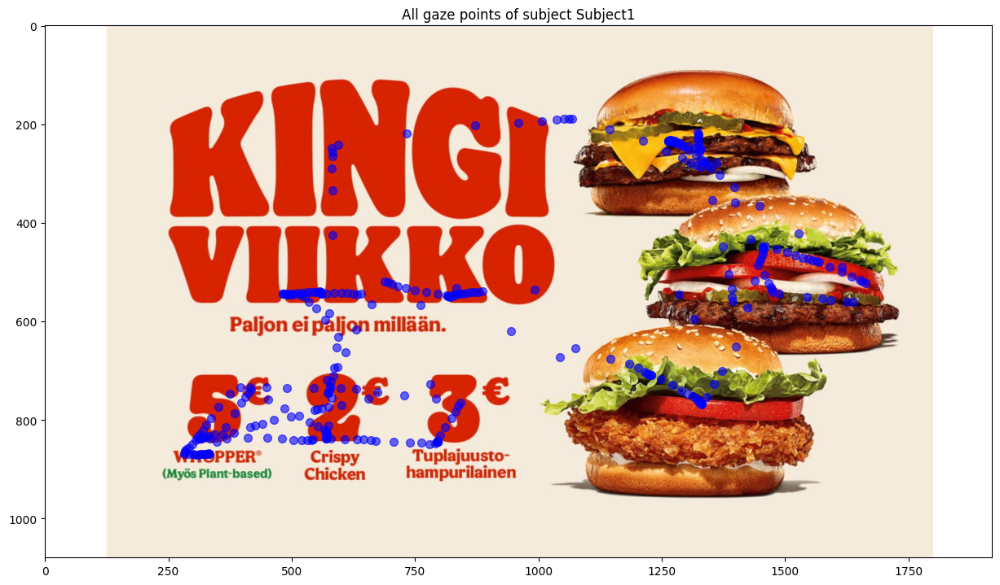

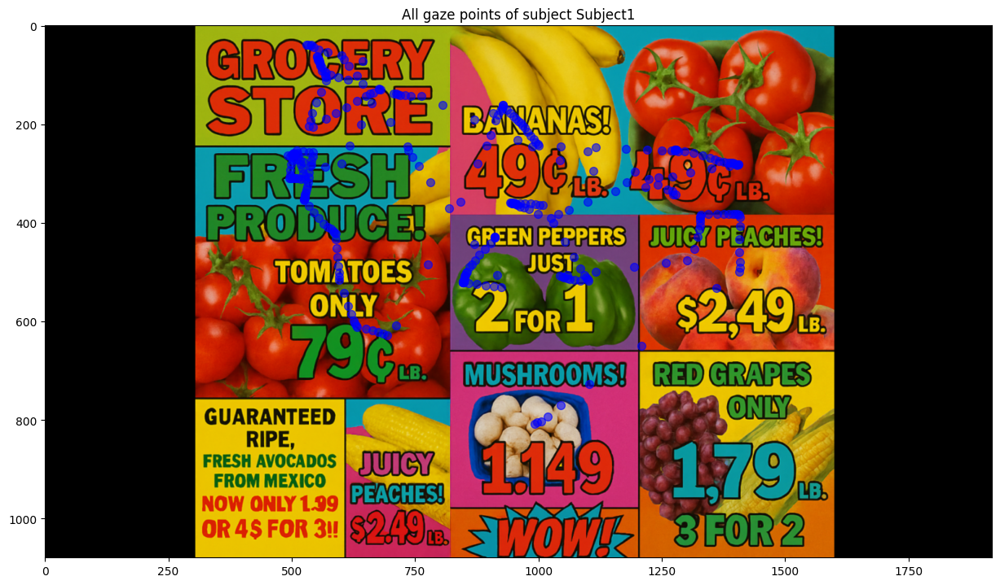

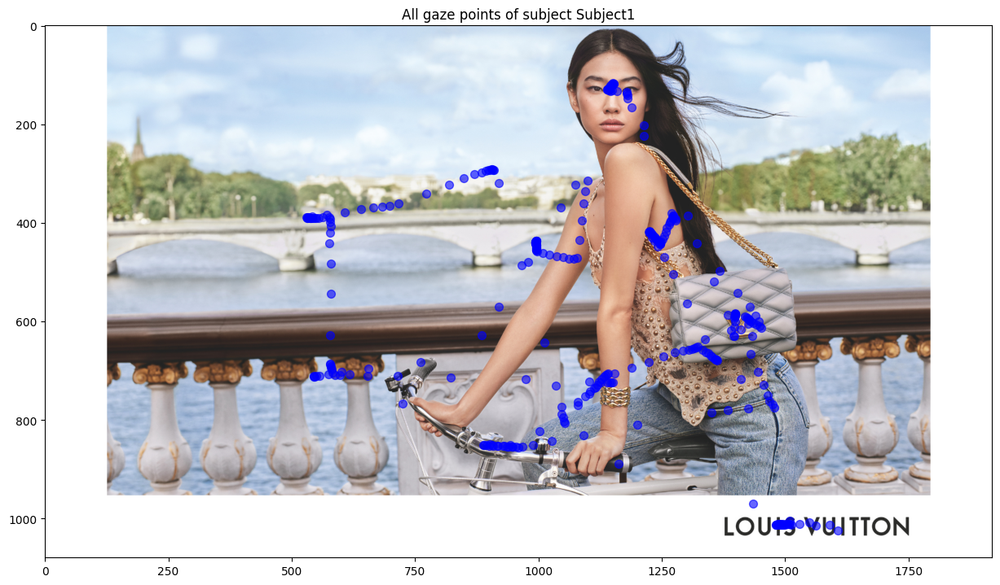

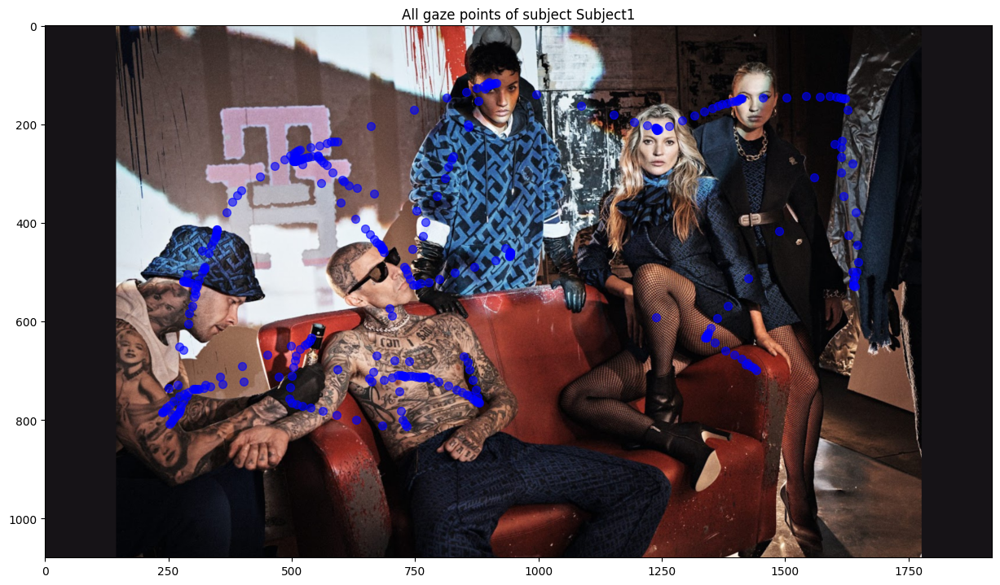

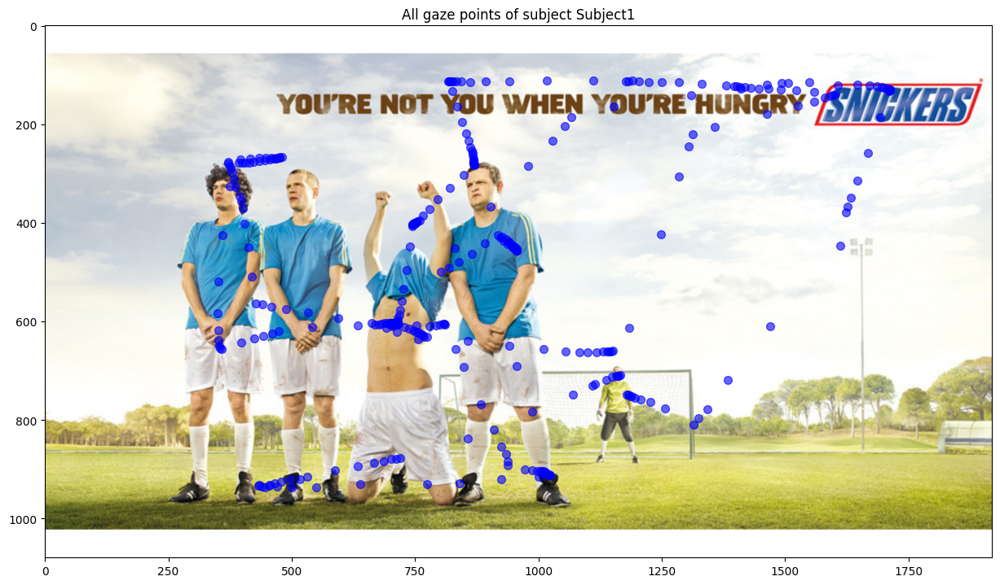

In [3]:
#By changing numbers below you can select subject which data you want to see and cahnge image to look
subject = 0  # change this number to select subject (0-..)

images = [mpimg.imread("Kuvat/A1.jpg"),mpimg.imread("Kuvat/B1.png"),
          mpimg.imread("Kuvat/C1.png"),mpimg.imread("Kuvat/D1.png"),mpimg.imread("Kuvat/E1.png")]

for i in range(len(images)):
    data = subjects[list(subjects.keys())[subject]][i]
    image = images[i]

    plt.figure(figsize=(15, 15))  # määritä leveys ja korkeus tuumina¨

    ##Lisätään kuvaajaan kuva muuttuja
    plt.imshow(image)
    plt.title("All gaze points of subject "+str(list(subjects.keys())[subject]))
    ##Lisätään datapisteet kuvaajaan.
    plt.scatter(data['x'], data['y'], c='blue', s=50, alpha=0.6)
    plt.show()

Visualize heatmap

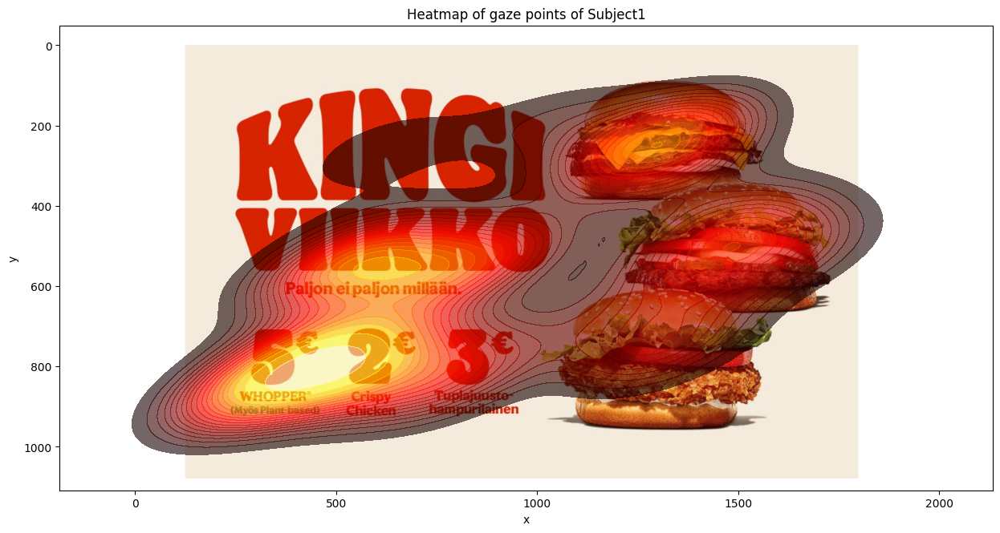

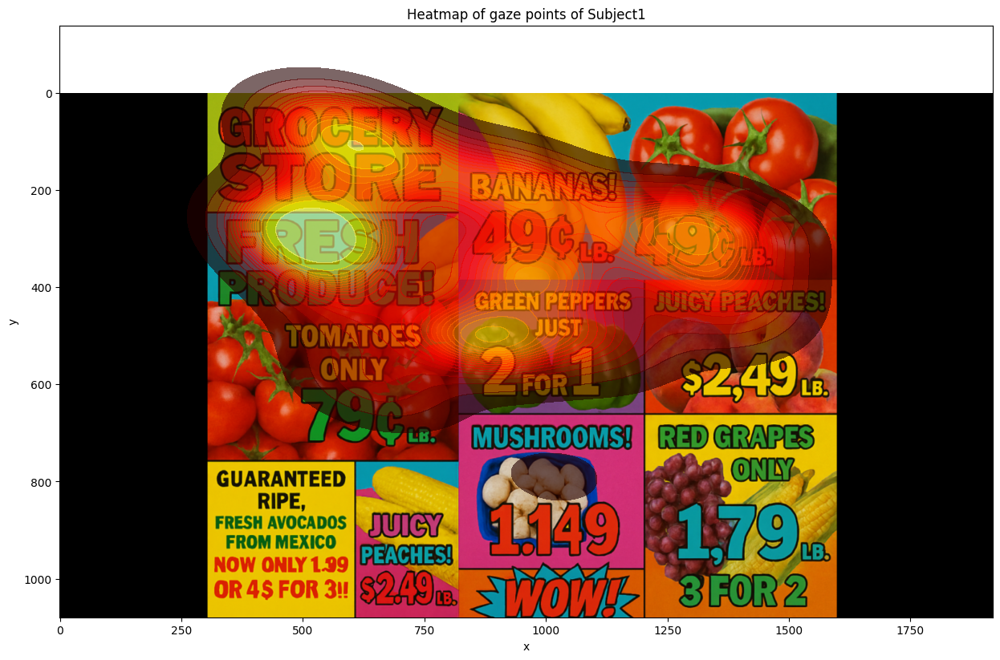

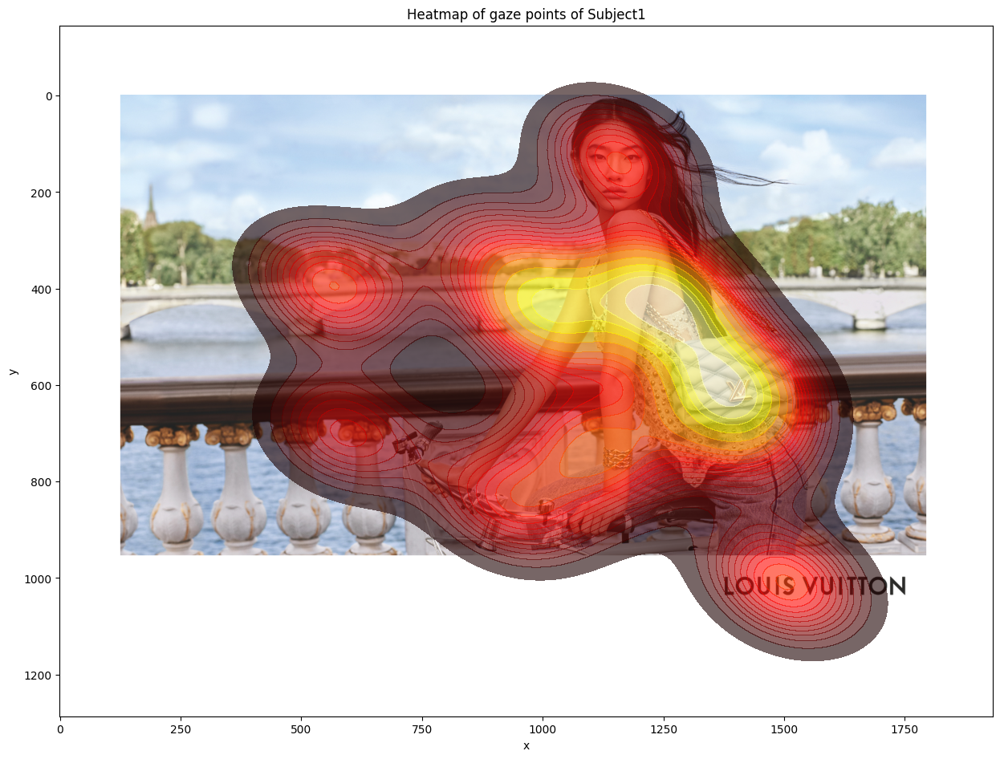

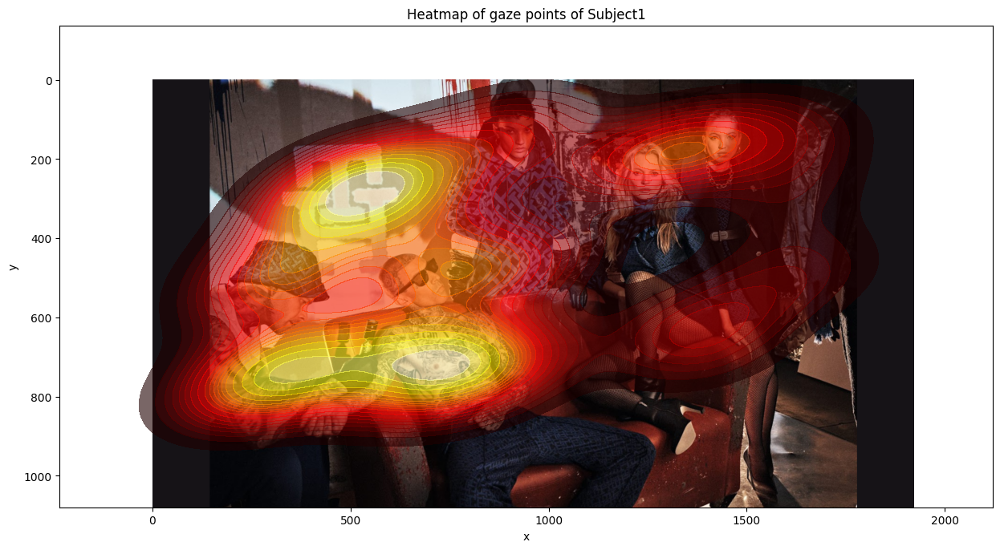

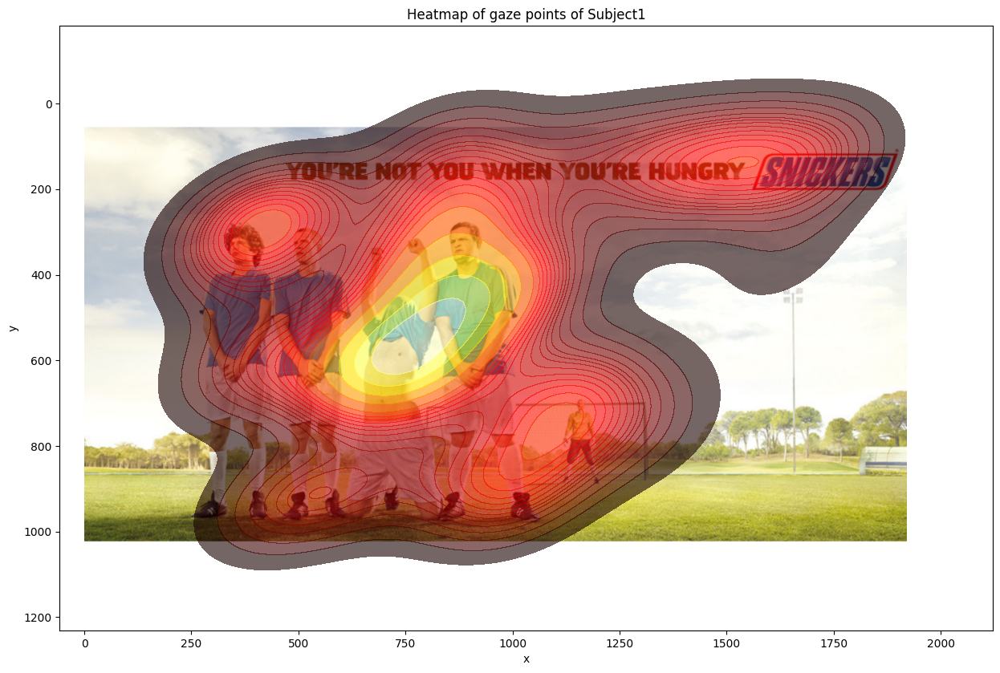

In [4]:
for i in range(len(images)):
    data = subjects[list(subjects.keys())[subject]][i]
    image = images[i]

    ##Plot heatmap for each task
    ##Choose figure size as inches (width and height)
    plt.figure(figsize=(15, 15))
    plt.title("Heatmap of gaze points of "+str(list(subjects.keys())[subject]))
    ##Add the image to the plot
    plt.imshow(image)
    ##Plot the heatmap
    sns.kdeplot(x=data['x'], y=data['y'], cmap="hot", fill=True, alpha=0.6,
                levels=20, ax=plt.gca())
    plt.show()

Fixation detection

In [5]:
velocity_threshold = 50  # threshold in pixels/second for deciding fixation vs saccade
fixations_list = []      # this will store the detected fixations later

current_fix = []         # temporary buffer to collect points belonging to the current fixation

# loop over all gaze points (starting from index 1 because we compare i and i-1)
for image_number in range(0, len(images)):
    image_data = subjects[list(subjects.keys())[subject]][image_number]

    for row in range(1, len(image_data)):
      # previous gaze point
      x_prev, y_prev, t_prev = image_data.iloc[row-1][['x', 'y', 'Time (s)']]
      # current gaze point
      x_curr, y_curr, t_curr = image_data.iloc[row][['x', 'y', 'Time (s)']]

      # calculates distance between points
      distance = np.sqrt((x_curr - x_prev)**2 + (y_curr - y_prev)**2)

      # time difference
      time_delta = t_curr - t_prev
      if time_delta == 0:
          continue

      # computes velocity between samples
      velocity = distance / time_delta

      # checks if this velocity is below threshold -> part of a fixation
      if velocity < velocity_threshold:
          # if this is the first point of a new fixation, mark start time
          if not current_fix:
              start_time = t_prev

          # add point to current fixation cluster
          current_fix.append((x_curr, y_curr))

          # update fixation end time
          end_time = t_curr

      else:
          # velocity exceeded threshold, fixation ends here
          if current_fix:
              # computes average fixation point
              xs, ys = zip(*current_fix)
              avg_x = np.mean(xs)
              avg_y = np.mean(ys)

              # stores the detected fixation
              fixations_list.append((avg_x, avg_y, start_time, end_time,
                                     image_number+1))

              # resets buffer for next fixation
              current_fix = []

    # saves the final fixation if there was one active at the end of the loop
    if current_fix:
        xs, ys = zip(*current_fix)
        avg_x = np.mean(xs)
        avg_y = np.mean(ys)
        fixations_list.append((avg_x, avg_y, start_time, end_time,
                               image_number+1))

# converts fixation list into DataFrame
fixations = pd.DataFrame(
    fixations_list,
    columns=['x', 'y', 'start_time', 'end_time', 'image']
)

# computes fixation duration
fixations['duration'] = fixations['end_time'] - fixations['start_time']

print(fixations)

              x            y  start_time  end_time  image  duration
0    818.161611   549.191498        0.39      0.57      1      0.18
1    572.921448   744.872620        1.12      1.15      1      0.03
2    795.250146   844.489746        3.72      3.87      1      0.15
3    570.027283   838.066772        5.71      5.74      1      0.03
4    481.706787   544.668701        6.25      6.28      1      0.03
5    559.691783   542.363444        6.59      6.77      1      0.18
6   1228.422119   708.851990        7.28      7.31      1      0.03
7   1328.079590   765.652405        7.58      7.61      1      0.03
8   1330.895081   767.661652        7.64      7.70      1      0.06
9   1264.173808   233.291865        9.12      9.30      1      0.18
10   911.456746   429.886556        0.00      0.09      2      0.09
11   847.468248   520.210517        0.51      0.79      2      0.28
12   677.129028   129.666031        3.32      3.35      2      0.03
13   525.860260   349.544800        4.95      5.

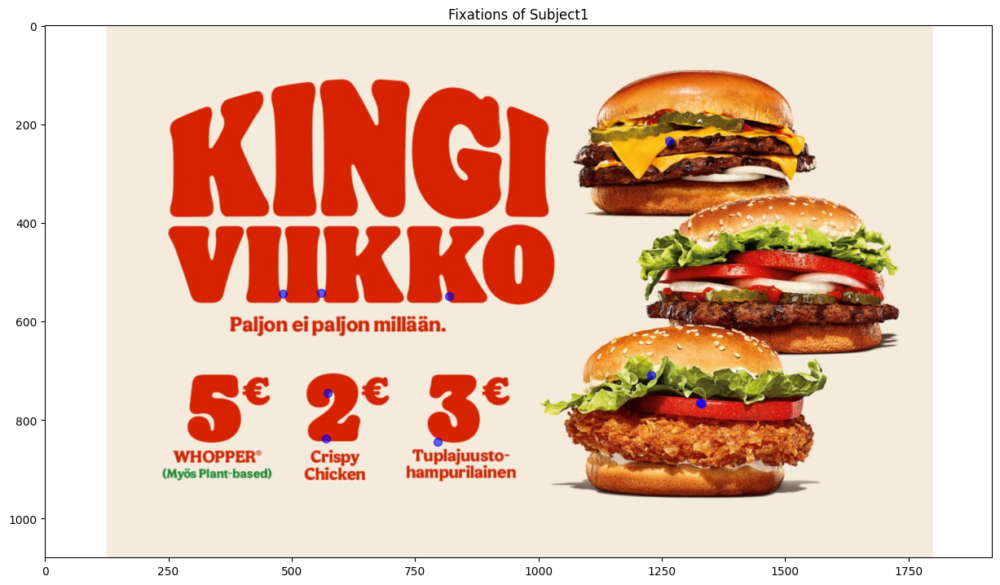

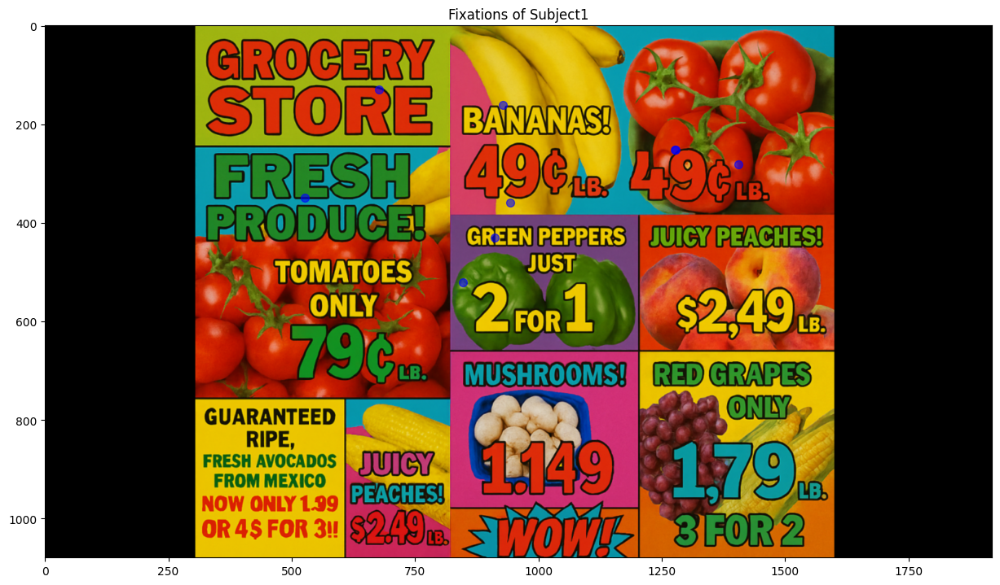

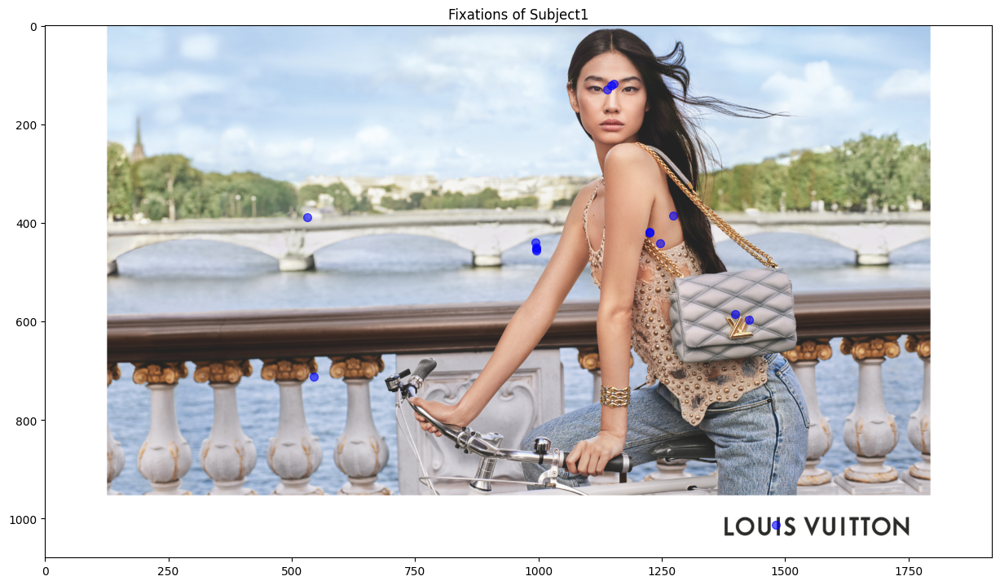

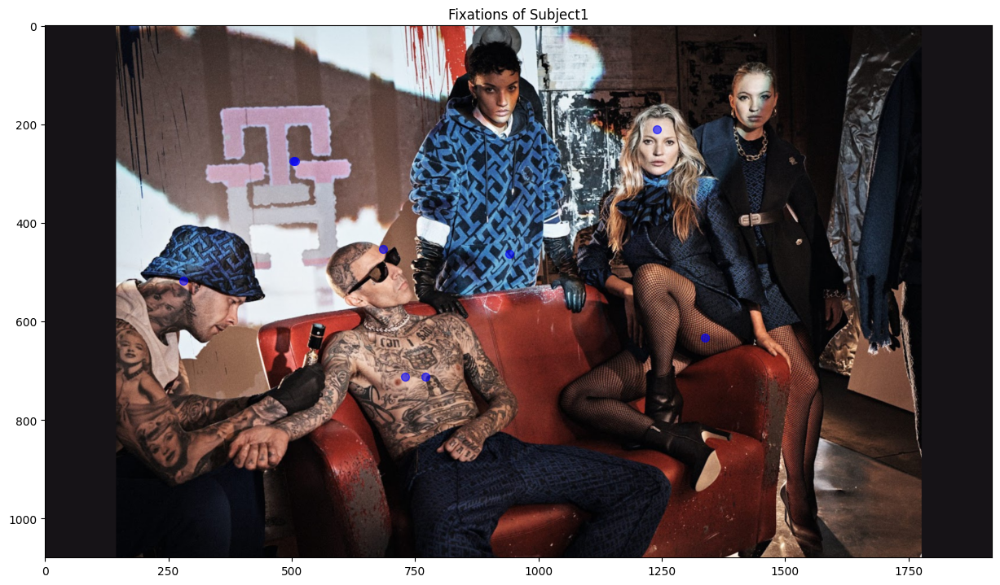

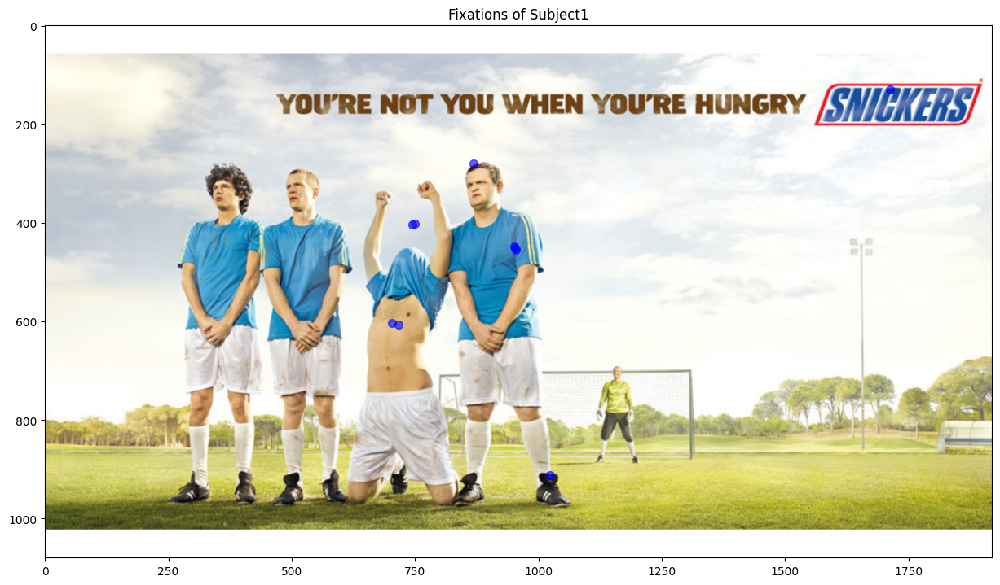

In [6]:
# Fixation visualization

for i in range(len(images)):
    data = fixations[fixations['image'] == i + 1]
    image = images[i]

    plt.figure(figsize=(15, 15))  # määritä leveys ja korkeus tuumina¨

    ##Lisätään kuvaajaan kuva muuttuja
    plt.imshow(image)
    plt.title("Fixations of "+str(list(subjects.keys())[subject]))
    ##Lisätään datapisteet kuvaajaan.
    plt.scatter(data['x'], data['y'], c='blue', s=50, alpha=0.6)
    plt.show()

Visualize scanpath

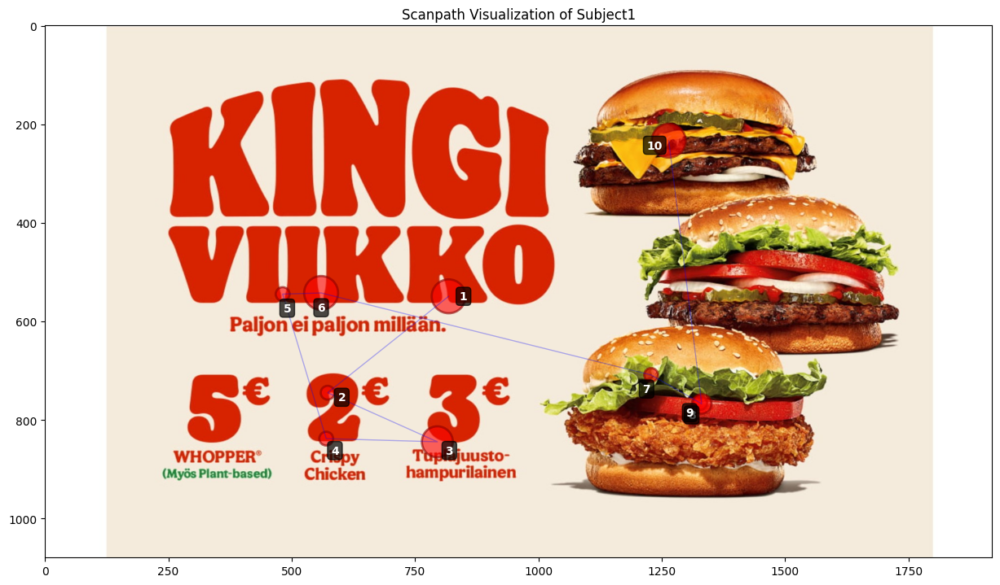

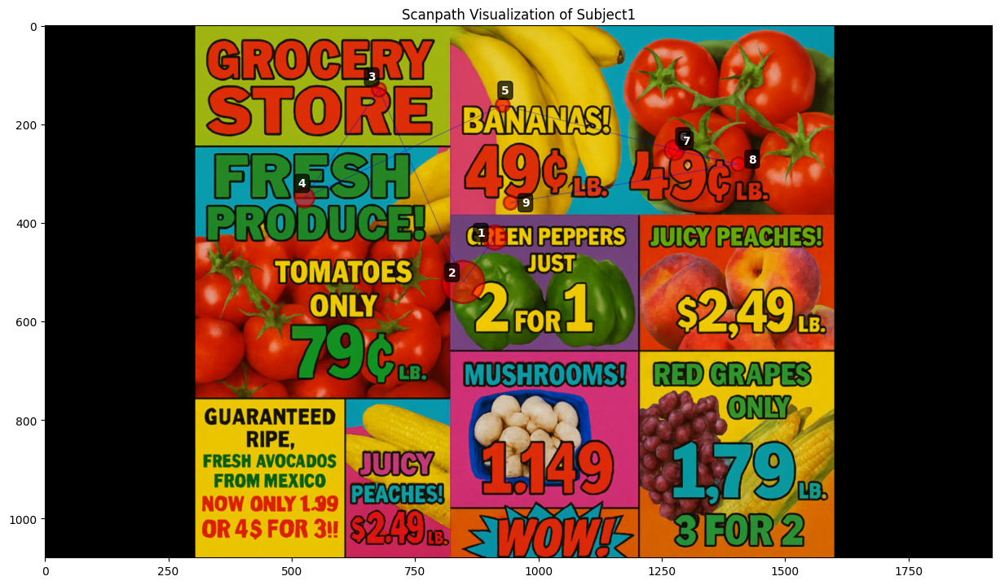

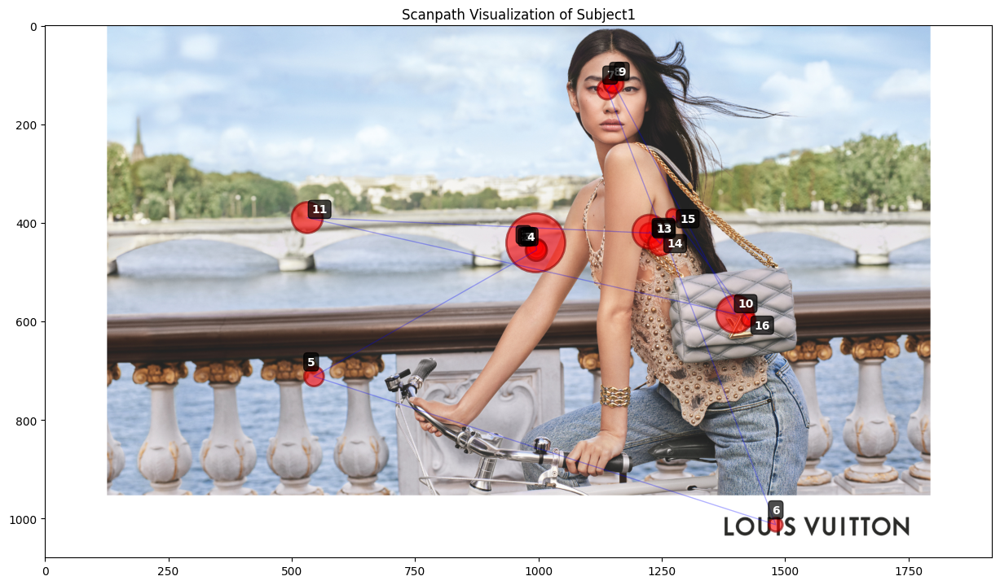

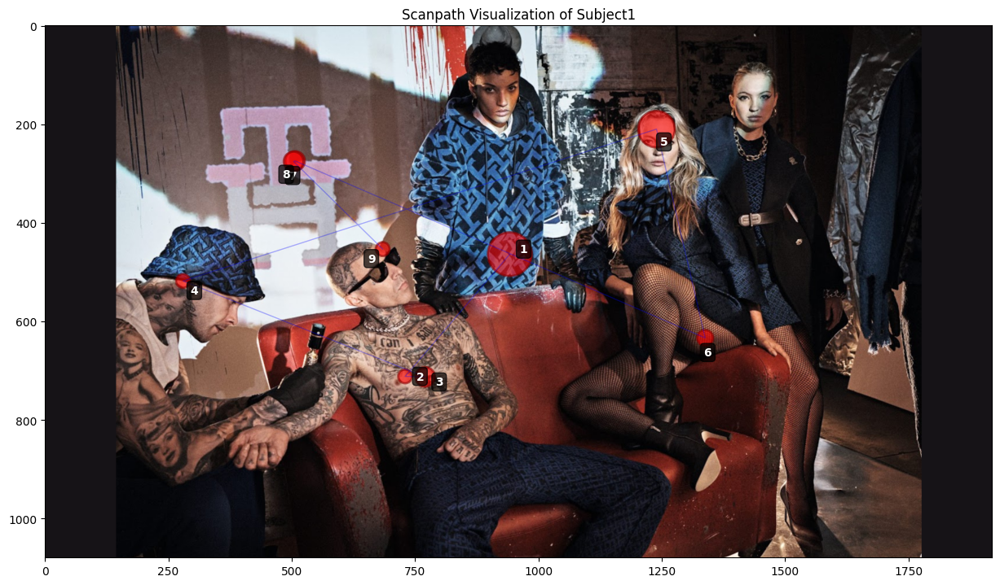

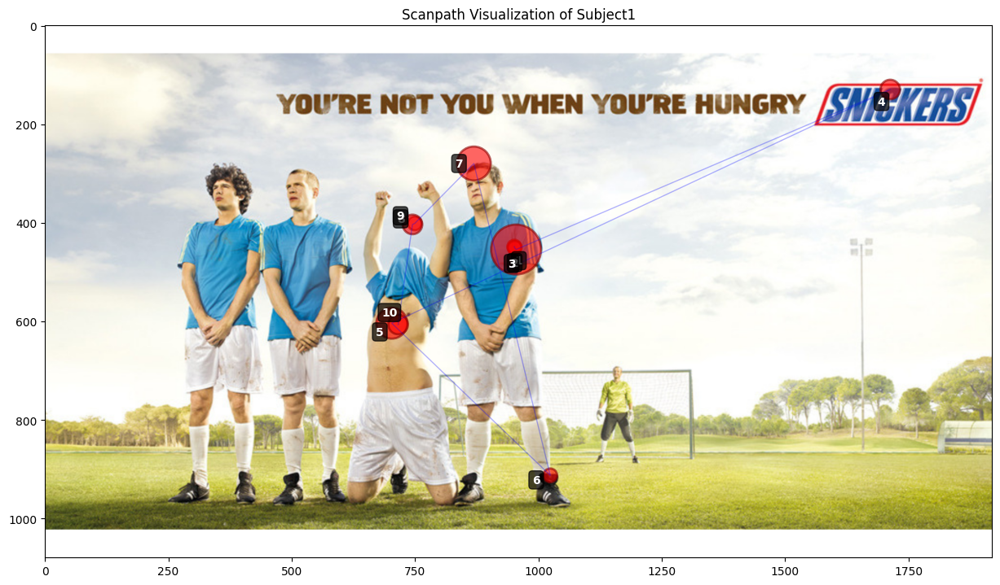

In [7]:
for i in range(len(images)):
    image = images[i]

    # Create scanpath visualization with fixations connected by lines
    plt.figure(figsize=(15, 15))
    plt.imshow(image)

    data = fixations[fixations['image'] == i + 1]

    # Plot fixations as circles, sized by duration
    plt.scatter(data['x'], data['y'], s=data['duration']*5000,
                c='red', alpha=0.6, edgecolors='darkred', linewidth=2)

    # Draw lines connecting fixations in sequence
    plt.plot(data['x'], data['y'], 'b-', alpha=0.3, linewidth=1)

    # Add fixation numbers with offset to avoid overlap
    fixation_num = 1
    for idx, row in data.iterrows():
        offset_x = 30 * np.cos(idx * np.pi / len(data))
        offset_y = 30 * np.sin(idx * np.pi / len(data))
        plt.text(row['x'] + offset_x, row['y'] + offset_y, str(fixation_num),
                 color='white', fontsize=10, ha='center', va='center', weight='bold',
                bbox=dict(boxstyle='round,pad=0.3', facecolor='black', alpha=0.7))
        fixation_num += 1

    # Add title
    plt.title('Scanpath Visualization of ' + str(list(subjects.keys())[subject]))
    plt.show()

Print metrics for all showed images

In [8]:
# metrics dictionary
metrics = {
    'subject_id': [list(subjects.keys())[subject]],
    'MFD_cond_1': [],
    'MFD_cond_2': [],
    'MFD_cond_3': [],
    'MFD_cond_4': [],
    'MFD_cond_5': [],
    'MFD_SD_cond_1': [],
    'MFD_SD_cond_2': [],
    'MFD_SD_cond_3': [],
    'MFD_SD_cond_4': [],
    'MFD_SD_cond_5': [],
    'fixation_num_cond_1': [],
    'fixation_num_cond_2': [],
    'fixation_num_cond_3': [],
    'fixation_num_cond_4': [],
    'fixation_num_cond_5': [],
    'MFD_overall': [],
    'MFD_SD_overall': []
    }

name = list(subjects.keys())[subject]

for i in range(len(images)):
    data = fixations[fixations['image'] == i+1]

    condition = "cond_" + str(i+1)
    # Calculate and print scanpath metrics for each task
    # Calculate scanpath metrics
    print("\n=== Scanpath Metrics: "+ name +" ===\n")

    # Average fixation duration
    avg_fixation_duration = data['duration'].mean()
    print(f"Average fixation duration: {avg_fixation_duration:.4f} seconds")
    metrics["MFD_" + condition] = avg_fixation_duration

    # Total fixation time
    total_fixation_time = data['duration'].sum()
    print(f"Total fixation time: {total_fixation_time:.2f} seconds")

    # standard deviation
    standard_deviation_fixations = data['duration'].std()
    if len(data) < 2:
        standard_deviation_fixations = 0
    metrics["MFD_SD_" + condition] = standard_deviation_fixations

    # fixation number
    print(f"Total number of fixations: {len(data)}")
    metrics["fixation_num_" + condition] = len(data)
    print(f"Standard deviation of fixations: {standard_deviation_fixations:.4f} seconds\n")


# aggregated stats
overall_mfd = fixations['duration'].mean()
aggre_std = fixations['duration'].std()

print(f"Aggregated mean fixation duration: {overall_mfd:.4f} seconds")
print(f"Aggregated standard deviation of fixations: {aggre_std:.4f} seconds\n")

metrics["MFD_overall"] = overall_mfd
metrics["MFD_SD_overall"] = aggre_std


=== Scanpath Metrics: Subject1 ===

Average fixation duration: 0.0900 seconds
Total fixation time: 0.90 seconds
Total number of fixations: 10
Standard deviation of fixations: 0.0721 seconds


=== Scanpath Metrics: Subject1 ===

Average fixation duration: 0.0711 seconds
Total fixation time: 0.64 seconds
Total number of fixations: 9
Standard deviation of fixations: 0.0812 seconds


=== Scanpath Metrics: Subject1 ===

Average fixation duration: 0.1062 seconds
Total fixation time: 1.70 seconds
Total number of fixations: 16
Standard deviation of fixations: 0.1290 seconds


=== Scanpath Metrics: Subject1 ===

Average fixation duration: 0.0911 seconds
Total fixation time: 0.82 seconds
Total number of fixations: 9
Standard deviation of fixations: 0.0965 seconds


=== Scanpath Metrics: Subject1 ===

Average fixation duration: 0.1020 seconds
Total fixation time: 1.02 seconds
Total number of fixations: 10
Standard deviation of fixations: 0.1142 seconds

Aggregated mean fixation duration: 0.0941 

Create/save CSV file

In [9]:
# Create a DataFrame from the metrics
metrics_df = pd.DataFrame(metrics)

# filename
output_filename = "eye_tracking_metrics.csv"

if os.path.exists(output_filename):
    metrics_df.to_csv(output_filename, mode="a", header=False, index=False)
    print(f"Metrics saved to {output_filename}")

else:
    # Save the DataFrame to a CSV file
    metrics_df.to_csv(output_filename, index=False)

    print(f"New file created to {output_filename}")

Metrics saved to eye_tracking_metrics.csv
